<a href="https://colab.research.google.com/github/v-vedantha/FourCam/blob/master/FourCamera.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
% pip install plotly.express

In [ ]:
import numpy as np
import math
from google.colab import drive
import PIL
from PIL import Image
import plotly.express as px
import plotly as pl
import time
from IPython import display
from matplotlib import pyplot as plt

In [ ]:
drive.mount('/content/gdrive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/gdrive


In [ ]:
cd gdrive/My\ Drive

/content/gdrive/My Drive


In [ ]:
R1=Image.open('BL.JPG')
BL_numpy = np.asarray(R1)
L1 = Image.open('BR.JPG')
BR_numpy = np.asarray(L1)
R2=Image.open('TL.JPG')
TL_numpy = np.asarray(R2)
L2 = Image.open('TR.JPG')
TR_numpy = np.asarray(L2)
C = Image.open('Center.JPG')
Center_numpy = np.asarray(L2)


In [ ]:
# Not used right now 
class CameraArray():
    def __init__(self, top_left, top_right, bottom_left, bottom_right, center):
        self.top_left = top_left
        self.top_right = top_right
        self.bottom_left = bottom_left
        self.bottom_right = bottom_right
        self.center = center
        self.images = [top_left, top_right, bottom_left, bottom_right]
        self.pixel_used_probability = cp.zeros((4, top_left.picture.shape[0], top_left.picture.shape[1]))
        self.all_zs = cp.zeros_like(self.pixels_all_scores)
        self.center_scores = cp.ones_like(top_left.picture)
        self.center_max_scores = cp.ones_like(self.center_scores)
        # The "ignoring" sequence
        x = cp.arange(-10, 11)
        y=norm.pdf(x, scale=7)
        self.mask = (y*y.reshape(-1,1)) * 1.75
    
    
    def increment_correctness(self, pixel_values, correctness):
        # We'll take the difference from the average value. We want to make sure
        # that if a pixel is blocked it doesn't have much of an effect on the score.
        # If the pixel is different and unblocked it should be bad for the score.
        # One way to deal with this is that if the pixel is blocked it must have 
        # been used earlier and had a high score. So maybe an idea is to test
        # and see if the score of that pixel or something near it has been high
        # in the past.
        # To do this we store the pixel score for each pixel at all z's. Then we
        # can just mask and see if that one has hit a peak before. Better yet is 
        # if we mark a pixel as "used" if it's hit its peak before and then ignore 
        # it from now on.
        
        # Calculates correctness * function for ignoring pixels
        value, num_tokens = 0,0
        pixel_importances = []
        for camera in range(4):
            if pixel_values[camera] == None:
                pixel_importances.append(None)
                continue
            x, y = pixel_values[camera]
            pixel_score = 1-((1-scaling(pixel_values[4][2]/self.all_zs[camera, x, y])) * self.pixel_used_probability[camera, x, y])
            value += self.images[camera].picture[x,y] * pixel_score
            num_tokens += pixel_score
            pixel_importances.append(pixel_score)

        # Average pixel
        average_pixel = value/num_tokens

        # Calculate distance from average pixel
        dist_from_avg = [1,1,1,1]
        for camera in range(4):
            if pixel_values[camera] == None:
                continue
            x, y = pixel_values[camera]
            dist_from_avg[camera] = difference(self.images[camera].picture[x,y], average_pixel, pixel_importances[camera])
            correctness *= dist_from_avg[camera]
        
        #
        # Change the pixel scores so that a high correctness causes scores to decrease for both that pixel and nearby pixels with same hue.
        # Ignoring same hue for now just setting nearby x pixels to lower value
        # The z value will matter because pixels near that z value may have a slight dependence on this but farther away they shouldn't
        # The importance of a pixel will be high at nearby z and drop off.
        # The nearby pixels should also have this drop off.
        # However if  they have a different hue they should not drop off as much.
        # To reduce time we can just determine the function in terms of z and hue difference.
        #

        # If a pixel's importance * correctness is high then replace the nearby pixels 
        for camera in range(4):
            if pixel_values[camera] == None:
                continue
            x, y = pixel_values[camera]
            if pixel_importances[camera] * cp.log(correctness) > self.pixel_used_probability[camera, x, y]:
                # Multiply mask by the hue and lighting factors
                mask_to_apply = mask * scaling(self.images[camera].picture[x-10:x+11, y-10:y+11,0]/average_pixel[0])
                mask_to_apply *= scaling(self.images[camera].picture[x-10:x+11, y-10:y+11,2]/average_pixel[2])

                # Include correctness in mask
                mask_to_apply *= cp.tanh(cp.log(correctness)/10)
                self.pixel_used_probability[camera, x-10:x+11, y-10:y+11] = cp.maximum(mask_to_apply, self.pixel_used_probability[camera, x-10:x+11, y-10:y+11])
                                
                # Store the z values
                self.all_zs[camera, x-10:x+11, y-10:y+11] = z

        return correctness, value

    # The fancy tanh log scaling
    def scaling(self, value, scale=1):
        return (1+cp.tanh(cp.log(scale/cp.abs(value-1))))/2

    # Difference function. Can be modified. 
    def difference(self, pixel, avg, importance):
        ratio_h = pixel[0]/avg[0]
        ratio_s = pixel[1]/avg[1]
        ratio_l = pixel[2]/avg[2]
        return 1-((1-(norm.pdf((ratio_h-1)*23)+.85) * (norm.pdf((ratio_l-1)*23)+.85) *
               (norm.pdf((ratio_s-1)*10)+.85))*importance**2)

    
    def recreate_image_at_z(self, z):
        # Recreates image at certain depth
        # When do we decide when a pixel is good enough?
        #   Look at actualy pixel values and check for match
        #   Mask from nearby pixels. If some have been used at similar depth then
        #   go with that. Maybe this mask has to be trained.
        # 
        for z in range(300,1000, 5): # Todo: Set up system which lowers the increment when we have high correctness values
            for x in range(20,300):
                for y in range(20,300):
                    pixel_values = []
                    for camera in range(4):
                        pixel_values.append(images.find_corresponding_pixel(x, y, z))
                    pixel_values.append((x, y, z))
                    self.center_scores[x,y], average = increment_correctness(pixel_values, self.center_scores[x,y])
                    self.center_scores[x,y] = cp.maximum(self.center_scores[x,y], 1)
                    if self.center_scores[x,y] > self.center_max_scores[x,y]:
                        self.center_max_scores[x,y] = self.center_scores[x,y]
                        self.center.picture[x, y] = average
                    
                    

In [ ]:
# Not used right now
class Camera():
    def __init__(self, x, y, z, x_angle, y_angle, picture, FOV, shape, fl=1):
        self.x = x
        self.y = y
        self.z = z
        self.x_angle = x_angle
        self.y_angle = y_angle
        
        self.picture = picture
        
        self.FOV_x, self.FOV_y = FOV
        self.x_pw, self.y_pw = shape

        self.x_ppw = 2*math.tan(self.FOV_x/2)/self.x_pw
        self.y_ppw = 2*math.tan(self.FOV_y/2)/self.y_pw
        self.focal_length = fl # Eventually, we can use this to calculate FOV

        self.x_axis = cp.array([1,0,0])
        self.y_axis = cp.array([0,1,0])
        self.z_axis = cp.array([0,0,1])
        # Now rotate axis about angles
        # I don't know how to do this right now so I am going to skip it.


    def find_corresponding_pixel(self, x, y, z):
        # The relative positioning to that point.
        r_x = x-self.x
        r_y = y-self.y
        r_z = z-self.z

        vector_to_point = cp.array([r_x, r_y, r_z])

        # Convert into vectors that are "relative to the plane of the camera"
        # We dot the vector with each axis.
        v_x = vector_to_point.dot(self.x_axis)
        v_y = vector_to_point.dot(self.y_axis)
        v_z = vector_to_point.dot(self.z_axis)
        
        # Set the z component to constant value (1)
        v_x = v_x/v_z
        v_y = v_y/v_z
        
        # Now we have the vectors to each point. Converting to pixels should be 
        # simple.
        # Lets try the basic version
        # The ratio is pixels = FOV
        print(v_x, v_y)
        print(v_x/self.x_ppw)
        p_x = -v_x/self.x_ppw + self.x_pw/2
        p_y = -v_y/self.y_ppw + self.y_pw/2
        if v_x > self.x_pw or v_y > self.y_pw:
            return None
        else:
            return (p_x, p_y)
        
    def find_corresponding_xyz(self, pixel, z):
        x, y = pixel

        # Need to fix negative signs later
        v_x = -(x-self.x_pw/2)*self.x_ppw
        v_y = -(y-self.y_pw/2)*self.y_ppw

        # Currently I'm using z since it will be more accurate near the center 
        return v_x * z, v_y * z, z
    

In [ ]:
# The holy grail
class MultiCam():
    def __init__(self, cameras, virtual):
        self.cameras = cameras
        self.virtual = virtual
    
    
    def get_line(self):
        # Returns 6 n by m vector coefficients: bx, mx, by, my, bz, mz
        # bx, by, bz are just the starting positions of the image so just set those up
        bx, by, bz = self.virtual.x, self.virtual.y, self.virtual.z

        # The m's are the pixels but each pixel times the value needed for the angle to work out
        mx, my = self.pixel_grid_to_m('x', self.virtual), self.pixel_grid_to_m('y', self.virtual)
        
        return bx, by, bz, mx, my
        
    def pixel_grid_to_m(self, direction, camera):
        
        if direction == 'x':
            return (np.arange(camera.x_pixels)-(camera.x_pixels/2))*2/camera.x_pixels * np.tan(camera.xhfov)
        elif direction == 'y':
            return -(np.arange(camera.y_pixels)-(camera.y_pixels/2))*2/camera.y_pixels * np.tan(camera.yhfov)
    
    def px_to_m(self, camera, px, py):

        return (px-(camera.x_pixels/2))*2*np.tan(camera.xhfov)/camera.x_pixels, -(py-(camera.y_pixels/2))*2*np.tan(camera.yhfov)/camera.y_pixels
    
    def m_to_px(self, camera, mx, my):
        
        return camera.x_pixels/2/np.tan(camera.xhfov)*mx + (camera.x_pixels/2), -camera.y_pixels/2/np.tan(camera.yhfov)*my + (camera.y_pixels/2)

    def t_to_px(self, camera, bx, by, bz, mx, my, t, isinfinite=False):
        # The ending point is when the angles match.

        point = (bx+mx*t)/(bz+t), (by+my*t)/(bz+t)
        
        if isinfinite:
            point = mx, my
        
        px, py = self.m_to_px(camera, point[0], point[1])
        
        return px, py

    def px_to_t(self, camera, bx, by, bz, mx, my, px, py):
        #print(px, py)
        slopes = self.px_to_m(camera, px, py)
        #print(slopes)
        #print(slopes[0], bz, bx, mx)

        t = (slopes[0]*bz-bx)/(mx-slopes[0])
        t2 = (slopes[1]*bz-by)/(my-slopes[1])
        #print((t/t2)[::20])
        return t2
        
    def get_pixel_range(self, bottom, top, camera):
        # We just want to shift this into the correct frame
        
        bottom, top = list(bottom), list(top)
        
        slope = (top[1]-bottom[1])/(top[0]-bottom[0])
        for element in [bottom, top]:
            if element[0] < 0:
                element[1]+=slope*(0-element[0])
                element[0] = 0
            elif element[0] > camera.x_pixels:
                element[1]-=slope*(element[0]-camera.x_pixels)
                element[0] = camera.x_pixels
            if element[1] < 0:
                element[0]+=1/slope*(0-element[1])
                element[1] = 0
            elif element[1] > camera.y_pixels:
                element[0]-=1/slope*(element[1]-camera.y_pixels)
                element[1] = camera.y_pixels
        
        
        distance = int(math.sqrt((bottom[0]-top[0])**2 + (bottom[1]-top[1])**2))//3
        
        #print(distance, bottom, top)

        # This line is what takes a long time. One option is to just reduce the number of elements 
        x, y = np.linspace(bottom[0], top[0], distance), np.linspace(bottom[1], top[1], distance)
        
        #print(b-a, c-b, d-c)
        return list(self.get_within_frame(x, y, self.cameras[0]))

    def get_within_frame(self, x, y, camera, returnMask=False):
        mask = np.arange(x.shape[0])
        y = y[x<camera.x_pixels]
        mask = mask[x<camera.x_pixels]
        x = x[x<camera.x_pixels]       
        y = y[x>=0]
        mask = mask[x>=0]
        x = x[x>=0]
        x = x[y<camera.y_pixels]
        mask = mask[y<camera.y_pixels]
        y = y[y<camera.y_pixels]
        x = x[y>=0]
        mask = mask[y>=0]
        y = y[y>=0]
        if not returnMask:
            return x, y
        else:
            return x, y, mask

    def pixel_in_range(self, camera, px, py):
        return px > 0 and px < camera.x_pixels and py > 0 and py < camera.y_pixels

    # Repeat for lower cameras TODO
    def create_epistatic_list(self):
        # Currently only for two cameras.
        # Calculate the entry point for each camera.
        # Convert line onto each plane
        # Current plan is plug in for t = 0, t = large. Find points and go along until fail
        self.epistatic_lines = []
        bx, by, bz, mx, my = self.get_line()
        too=[0,0,0,0,0,0,0,0,0]
        for x in range(self.virtual.x_pixels):
            print(x)
            self.epistatic_lines.append([])
            for y in range(self.virtual.y_pixels):
                # We can do some math to find the end points. This should speed up by a large amount.
                a=time.time()
                self.epistatic_lines[x].extend([[[[],[]],[[],[]]]])
                # If we find all the bottoms nad the tops then do the math faster, will it work?
                b=time.time()
                # Goes through each point in the range of the first camera
                bottom = self.t_to_px(self.cameras[0], -self.cameras[0].x+bx, -self.cameras[0].y+by, -self.cameras[0].z+bz, mx[x], my[y], 1)
                
                c=time.time()
                top = self.t_to_px(self.cameras[0], -self.cameras[0].x+bx, -self.cameras[0].y+by, -self.cameras[0].z+bz, mx[x], my[y], 1, isinfinite=True)
                d=time.time()
                
                
                #print(bottom, top)                
                pixel_range = self.get_pixel_range(bottom, top, self.cameras[0])
                

                e=time.time()
                
                t = self.px_to_t(self.cameras[0], -self.cameras[0].x+bx, -self.cameras[0].y+by, -self.cameras[0].z+bz, mx[x], my[y], pixel_range[0], pixel_range[1])
                
                
                f=time.time()
                
                # Gets teh corresponding second camera pixels
                #print(pixel_range)
                #print('++=++=+++==+++++++=++++++==++=')
                #other_px, other_py = self.t_to_px(self.cameras[0], 
                #                        -self.cameras[0].x+bx, -self.cameras[0].y+by, -self.cameras[0].z+bz, mx[x], my[y], t)
                
                #print(other_px, other_py)
                other_px, other_py = self.t_to_px(self.cameras[1], 
                                        -self.cameras[1].x+bx, -self.cameras[1].y+by, -self.cameras[1].z+bz, mx[x], my[y], t)
                g=time.time()
                other_px, other_py, mask = self.get_within_frame(other_px, other_py, self.cameras[1], returnMask=True)
                h=time.time()
                
                
                # Appplies mask to first camera
                pixel_range[0] = pixel_range[0][mask]
                pixel_range[1] = pixel_range[1][mask]
                i=time.time()
                # Stores pixels
                self.epistatic_lines[x][y][0][0] = pixel_range[0].astype(np.int16)
                self.epistatic_lines[x][y][0][1] = pixel_range[1].astype(np.int16)
                self.epistatic_lines[x][y][1][0] = other_px.astype(np.int16)
                self.epistatic_lines[x][y][1][1] = other_py.astype(np.int16)
                j=time.time()
                nList = [a, b, c, d, e, f, g, h, i, j]
                for o in range(1,len(nList)):
                    too[o-1]+=nList[o]-nList[o-1]
            print(too)
            too = [0,0,0,0,0,0,0,0,0]
        
        # Calculate exit point for each camera by finding the same angle on it.

        # Loop from entry to exit on camera which works in both directions.
        
        # Store results.
    
    def create_virtual_image(self):
        
        # Calculate all the differences
        # Probably need to find way to speed this up instead of doing it for each pixel
        # With 2 more cameras we can adjust so that something without a minimum is re-calculated with second stereocam
        # If you want to add another camera system just stick two more cameras in here with another epistatic line and select the pixel with
        # the lower difference.
        # This method is better than doing a stereo reconstruction and then pivoting because I feel like doing the full reconstruction 
        # requires getting useless points and it creates bad results. Using this technique we aren't really trying to solve the full problem
        # just coming up with a reasonable solution for a sub-problem.
        # The technique is just to pick the pixels with the lower difference.
        # Improvements include: using opencv large section to better map textures. That's for later
        true_min = np.zeros((self.virtual.image.shape[0], self.virtual.image.shape[1]))
        for x in range(self.virtual.x_pixels):
            for y in range(self.virtual.y_pixels):
                diff = self.cameras[1].image[self.epistatic_lines[x][y][1]]-self.cameras[0].image[self.epistatic_lines[x][y][0]] # Only set up for 2 cameras
                
                diff = np.abs(diff)
                diff = np.power(diff, 2)
                # Sum across pixel direction
                diff = np.sum(diff, axis = 1)
                #Trying a convolution
                conv_depth = min(6, diff.shape[0]-1)
                diff = np.convolve(diff, np.ones((conv_depth))/conv_depth, 'valid')
                # Find lowest pixel
                true_min[x,y] = np.min(diff)
                minimum = np.argmin(diff)+conv_depth//2
                self.virtual.image[x,y] = self.cameras[1].image[self.epistatic_lines[x][y][1][0][minimum], self.epistatic_lines[x][y][1][1][minimum]] # Fancy schmancy
        return true_min
                

In [ ]:
# Placeholder for all stereo cameras
class MultiSteroCamera():
    def __init__(self, stereoPairs):
        self.stereoPairs = stereoPairs
        for pair in self.stereoPairs:
            pair.create_epistatic_list()
        self.x_pixels = stereoPairs[0].virtual.x_pixels
        self.y_pixels = stereoPairs[0].virtual.y_pixels
        self.output = np.zeros_like(self.stereoPairs[0].virtual.image)
        
    def generate_images(self):
        self.minimums = []
        for pair in self.stereoPairs:
            self.minimums.append(pair.create_virtual_image())

    def synthesize_images(self):
        wr = np.zeros_like(self.output)
        
        self.output = self.stereoPairs[1].virtual.image
        for x in range(self.x_pixels):
            for y in range(self.y_pixels):
                minimum_per_pixel = []
                for minimum in self.minimums:
                    minimum_per_pixel.append(minimum[x,y])
                
                argmin = np.argmin(minimum_per_pixel)
                if argmin != 1:
                    self.output[x,y] = self.stereoPairs[argmin].virtual.image[x,y]
                    wr[x, y] = np.array([255,255,255])
        return self.output, wr

In [ ]:
# Single camera
class TestCamera():
    def __init__(self, x, y, z, xh, yh, image):
        self.x=x
        self.y=y
        self.z=z
        self.image = image
        self.x_pixels = image.shape[0]
        self.y_pixels = image.shape[1]
        self.xhfov = xh
        self.yhfov = yh
    
    
        

In [ ]:
# Uses calibrated locations
x, y = 107, 96.5
c1 = TestCamera(0,0,0, .4092, .5243, BL_numpy)
c2 = TestCamera(200,0,0, .4092, .5243, BR_numpy)
v1 = TestCamera(x, y,0, .4, .5, np.zeros((96,128,3)))

c3 = TestCamera(0,177.8,0,.4092, .5243, TL_numpy)
c4 = TestCamera(200,177.8,0, .4092, .5243, TR_numpy)
v2 = TestCamera(x, y,0, .4, .5, np.zeros((96,128,3)))


In [ ]:
mc1 = MultiCam([c1, c2], v1)
mc2 = MultiCam([c1,c3], v2)


In [ ]:

multisc = MultiSteroCamera([mc1, mc2])

0
[0.0001494884490966797, 0.0015778541564941406, 0.0011959075927734375, 0.03477311134338379, 0.007322072982788086, 0.005483388900756836, 0.006859540939331055, 0.0002510547637939453, 0.0008611679077148438]
1
[0.00013947486877441406, 0.0013990402221679688, 0.0010542869567871094, 0.019584178924560547, 0.006511211395263672, 0.00426936149597168, 0.005269765853881836, 0.00023603439331054688, 0.0014421939849853516]
2
[0.00011563301086425781, 0.0012331008911132812, 0.0009393692016601562, 0.018213272094726562, 0.005449771881103516, 0.0038831233978271484, 0.004912137985229492, 0.00019097328186035156, 0.0012462139129638672]
3
[0.00011873245239257812, 0.0012238025665283203, 0.000942230224609375, 0.017834901809692383, 0.0053713321685791016, 0.0038373470306396484, 0.004853010177612305, 0.00019979476928710938, 0.0013289451599121094]
4
[0.00010895729064941406, 0.001211404800415039, 0.0009479522705078125, 0.01771235466003418, 0.005234479904174805, 0.0038073062896728516, 0.004964351654052734, 0.00020980

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:51: RuntimeWarning:

divide by zero encountered in true_divide

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:35: RuntimeWarning:

invalid value encountered in true_divide

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:88: RuntimeWarning:

invalid value encountered in less

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:89: RuntimeWarning:

invalid value encountered in less

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:90: RuntimeWarning:

invalid value encountered in less

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:35: RuntimeWarning:

invalid value encountered in multiply

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:50: RuntimeWarning:

divide by zero encountered in true_divide



[0.0001971721649169922, 0.0023877620697021484, 0.004225254058837891, 0.030640363693237305, 0.008146524429321289, 0.005494832992553711, 0.00797581672668457, 0.00032210350036621094, 0.002871990203857422]
6
[0.00011587142944335938, 0.0012958049774169922, 0.0010056495666503906, 0.018105268478393555, 0.0059244632720947266, 0.003960371017456055, 0.0052602291107177734, 0.00021982192993164062, 0.0012485980987548828]
7
[0.0001068115234375, 0.0012335777282714844, 0.0009183883666992188, 0.017771482467651367, 0.005349159240722656, 0.0038089752197265625, 0.005089282989501953, 0.00022101402282714844, 0.0012614727020263672]
8
[0.00011181831359863281, 0.0012545585632324219, 0.0009343624114990234, 0.01800537109375, 0.005720615386962891, 0.003907680511474609, 0.005178213119506836, 0.000232696533203125, 0.0012378692626953125]
9
[0.00012946128845214844, 0.0013320446014404297, 0.0010104179382324219, 0.01862192153930664, 0.00545954704284668, 0.0039975643157958984, 0.005388498306274414, 0.0002436637878417968

In [ ]:
multisc.generate_images()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:196: FutureWarning:

Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.



In [ ]:
op, wr = multisc.synthesize_images()

In [ ]:
figV = px.imshow(np.transpose(op, axes=(1,0,2)))
figV.show()

In [ ]:
figV = px.imshow(np.transpose(wr, axes=(1,0,2)))
figV.show()

In [ ]:
figV = px.imshow(np.transpose(multisc.stereoPairs[0].virtual.image, axes=(1,0,2)))
figV.show()

In [ ]:

figV = px.imshow(np.transpose(multisc.stereoPairs[1].virtual.image, axes=(1,0,2)))
figV.show()

In [ ]:
figV = px.imshow(np.transpose(multisc.minimums[0], axes=(1,0)))
figV.show()

In [ ]:
figV = px.imshow(np.transpose(multisc.minimums[1], axes=(1,0)))
figV.show()

In [ ]:
multisc.minimums[0]

array([[ 68.5       ,  26.83333333,   8.33333333, ...,  56.16666667,
         98.33333333,  75.33333333],
       [ 22.16666667,  16.66666667,  14.        , ...,  50.83333333,
        167.33333333,  51.5       ],
       [ 28.5       ,  20.5       ,  19.        , ...,  45.16666667,
         62.        ,  91.33333333],
       ...,
       [201.5       , 172.83333333, 187.83333333, ..., 171.66666667,
        242.33333333, 208.5       ],
       [246.66666667, 198.16666667, 224.66666667, ..., 210.16666667,
        252.66666667, 213.83333333],
       [191.83333333, 242.16666667, 235.5       , ..., 214.66666667,
        277.16666667, 247.16666667]])

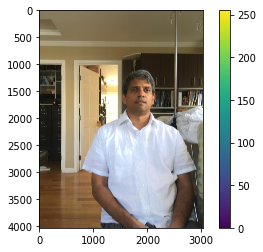

In [ ]:
fig = plt.figure()
ax=fig.add_subplot()
im = ax.imshow(np.transpose(Center_numpy, axes=(1,0,2)))
fig.colorbar(im)
plt.show()


The technique is as follows:

Every pixel corresponds to a certain angle. If we want to recreate the center picture we follow each pixel's angle-distance and the corresponding pixel of the 4 other cameras which should hit that angle, and only set the pixel when multiple cameras have the same pixel value =/- some error because of lighting. This should work although it is a slow process. We can figure out how to speed this up later.

This takes O(n^3) time which is large but if we shrink the camera down it should be fine. Some obvious optimizations would be that "far away" angles can probably be estimated somehow. Also... pixels can get used up which can speed things up because we then only lookat a maximujm of 4n^2 pixels.

After some testing, it seems anything occluded by 1 camera gets totally messed up when reconstruction happens. One fix is to use 2 stereo pairs near each other on both sides of object. I need to figure out how to save the minimums and not shrink the head but lets try it out.

More ways to speed up. Use some form of edge detector. This means find edges and match them. Maybe a form of convolution where a 5 by 5 pixel region is mapped out. This allows edges which exist in both images to be more clearly mapped out. 

In [ ]:
figV = px.imshow(np.transpose(v.image.astype(np.uint8), axes=(1,0,2)))
figV.show()

In [ ]:
figL = px.imshow(np.transpose(c1.image, axes=(1,0,2)))
figL.show()

In [ ]:
fig = px.imshow(R1_numpy)
fig.show()

In [ ]:
multisc.stereoPairs[0].epistatic_lines[65][20]

[[array([2817, 2815, 2813, 2810, 2808, 2806, 2804, 2801, 2799, 2797, 2795,
         2793, 2790, 2788, 2786, 2784, 2781, 2779, 2777, 2775, 2772, 2770,
         2768, 2766, 2763, 2761, 2759, 2757, 2754, 2752, 2750, 2748, 2746,
         2743, 2741, 2739, 2737, 2734, 2732, 2730, 2728, 2725, 2723, 2721,
         2719, 2716, 2714, 2712, 2710, 2707, 2705, 2703, 2701, 2699, 2696,
         2694, 2692, 2690, 2687, 2685, 2683, 2681, 2678, 2676, 2674, 2672,
         2669, 2667, 2665, 2663, 2660, 2658, 2656, 2654, 2651, 2649, 2647,
         2645, 2643, 2640, 2638, 2636, 2634, 2631, 2629, 2627, 2625, 2622,
         2620, 2618, 2616, 2613, 2611, 2609, 2607, 2604, 2602, 2600, 2598,
         2596, 2593, 2591, 2589, 2587, 2584, 2582, 2580, 2578, 2575, 2573,
         2571, 2569, 2566, 2564, 2562, 2560, 2557, 2555, 2553, 2551, 2548,
         2546, 2544, 2542, 2540, 2537, 2535, 2533, 2531, 2528, 2526, 2524,
         2522, 2519, 2517, 2515, 2513, 2510, 2508, 2506, 2504, 2501, 2499,
         2497, 2495, 2493

In [ ]:
multisc.stereoPairs[1].epistatic_lines[25][20]

[[array([], dtype=int16), array([], dtype=int16)],
 [array([], dtype=int16), array([], dtype=int16)]]

In [ ]:
multisc.minimums

[array([[ 74.33333333,  86.        ,  40.        , ...,  34.16666667,
          29.5       ,  34.66666667],
        [ 24.33333333,  44.        ,  18.33333333, ...,  26.33333333,
          29.83333333,  17.16666667],
        [ 18.33333333,  14.16666667,  16.66666667, ...,  44.33333333,
          32.83333333,  11.        ],
        ...,
        [ 64.        ,  27.5       ,  52.66666667, ..., 186.33333333,
         233.        , 159.33333333],
        [ 79.83333333,  98.83333333,  93.83333333, ..., 207.16666667,
         195.16666667, 170.16666667],
        [103.33333333, 100.66666667,  86.83333333, ..., 148.83333333,
         203.16666667, 103.5       ]]),
 array([[  3.83333333,   7.33333333, 218.66666667, ...,  23.5       ,
          50.        ,  12.5       ],
        [  7.66666667,  12.33333333, 210.83333333, ...,  18.5       ,
          32.        ,  19.        ],
        [ 13.33333333,   4.5       , 238.5       , ...,  14.16666667,
          16.16666667,  29.16666667],
        ...,


In [ ]:
plt.plot(np.arange(multisc.minimums[0][20,20].shape[0]), multisc.minimums[0][20,20])
plt.show()

IndexError: ignored

In [ ]:
np.arange(multisc.minimums[0][20,20].shape), (multisc.minimums[0][20,20])

TypeError: ignored

In [ ]:
multisc.minimums[0][25,20]

2.9999999999999996

Update. Instead of trying to reconstruct the whole image, what about just the eyes.set up bounding box around eyes and adjust those eye pixels to the new goal. To not use AI just find distances and go to within like 3 percent of that and it should be good. Then how do we reconstruct the eyes? 